In [1]:
import polars as pl

In [2]:
sell_in = pl.read_csv(
    "sell-in.txt",
    separator="\t",
)
sell_in.head()

periodo,customer_id,product_id,plan_precios_cuidados,cust_request_qty,cust_request_tn,tn
i64,i64,i64,i64,i64,f64,f64
201701,10234,20524,0,2,0.053,0.053
201701,10032,20524,0,1,0.13628,0.13628
201701,10217,20524,0,1,0.03028,0.03028
201701,10125,20524,0,1,0.02271,0.02271
201701,10012,20524,0,11,1.54452,1.54452


In [3]:
tb_productos = pl.read_csv(
    "tb_productos.txt",
    separator="\t",
)
tb_productos.head()

cat1,cat2,cat3,brand,sku_size,product_id
str,str,str,str,i64,i64
"""HC""","""ROPA LAVADO""","""Liquido""","""LIMPIEX""",900,20280
"""HC""","""ROPA LAVADO""","""Liquido""","""LIMPIEX""",450,20180
"""HC""","""ROPA LAVADO""","""Liquido""","""LIMPIEX""",120,20332
"""HC""","""ROPA LAVADO""","""Liquido""","""LIMPIEX""",450,20222
"""HC""","""ROPA LAVADO""","""Liquido""","""LIMPIEX""",900,20288


In [4]:

tb_stocks = pl.read_csv(
    "tb_stocks.txt",
    separator="\t",
)
tb_stocks.head()

periodo,product_id,stock_final
i64,i64,f64
201810,20524,1.61267
201810,20311,2.93657
201810,20654,6.83269
201810,21005,1.01338
201810,20974,0.34595


In [5]:
benchmark_df = pl.DataFrame()
# le agrego a benchmak_df los datos de sell_in, luego le mergeo productos por product_id y luego stock por periodo,product_id
benchmark_df = sell_in.join(tb_productos, on="product_id", how="left")
benchmark_df = benchmark_df.join(tb_stocks, on=["periodo", "product_id"], how="left")
benchmark_df.head()


periodo,customer_id,product_id,plan_precios_cuidados,cust_request_qty,cust_request_tn,tn,cat1,cat2,cat3,brand,sku_size,stock_final
i64,i64,i64,i64,i64,f64,f64,str,str,str,str,i64,f64
201701,10234,20524,0,2,0.053,0.053,"""HC""","""VAJILLA""","""Cristalino""","""Importado""",500,null
201701,10032,20524,0,1,0.13628,0.13628,"""HC""","""VAJILLA""","""Cristalino""","""Importado""",500,null
201701,10217,20524,0,1,0.03028,0.03028,"""HC""","""VAJILLA""","""Cristalino""","""Importado""",500,null
201701,10125,20524,0,1,0.02271,0.02271,"""HC""","""VAJILLA""","""Cristalino""","""Importado""",500,null
201701,10012,20524,0,11,1.54452,1.54452,"""HC""","""VAJILLA""","""Cristalino""","""Importado""",500,null


In [6]:
# count el total de customers ids
# dataframe object has no attribute groupby
benchmark_df.group_by("customer_id").len().select("customer_id")

customer_id
i64
10010
10004
10233
10525
10388
…
10587
10328
10453


In [7]:
#cuento la cantidad de skus que hay en el df
benchmark_df.group_by("product_id").len().select("product_id")

product_id
i64
20329
20210
20752
20207
20344
…
20305
20055
20689


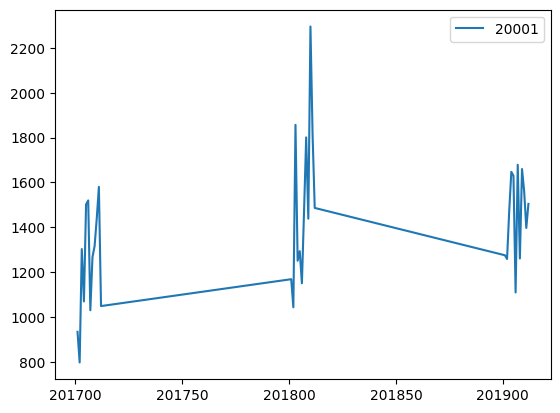

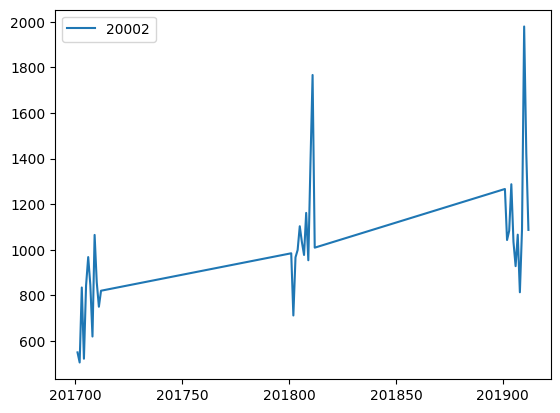

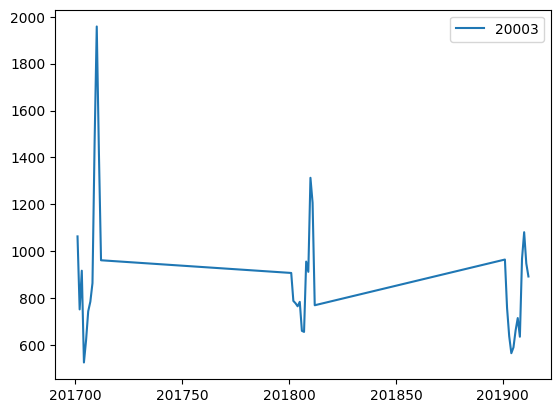

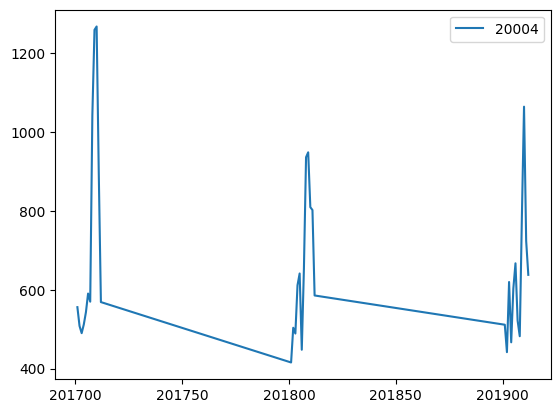

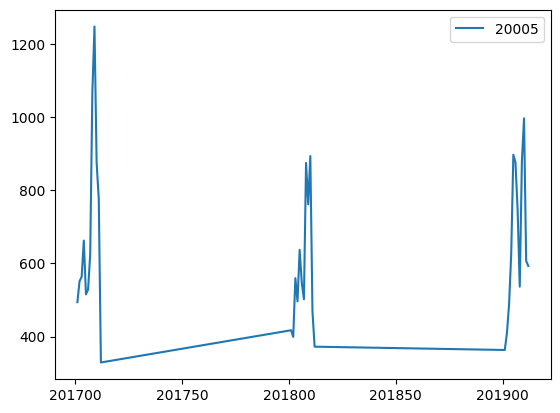

...

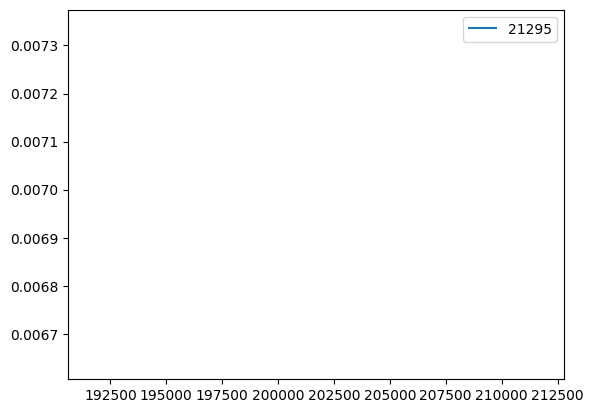

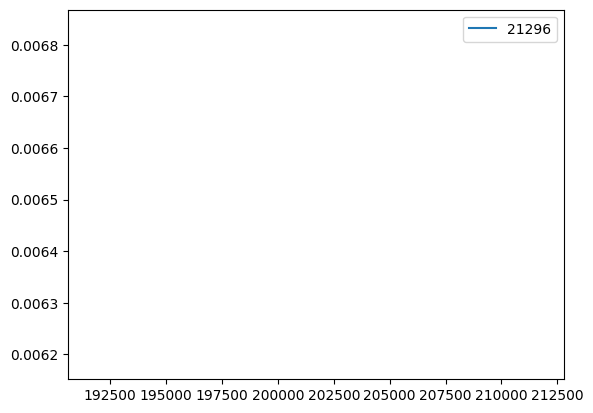

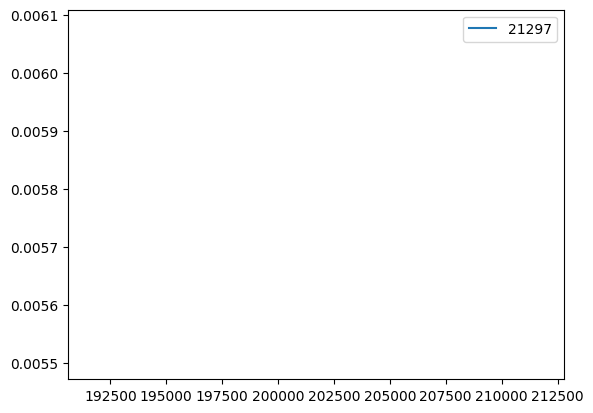

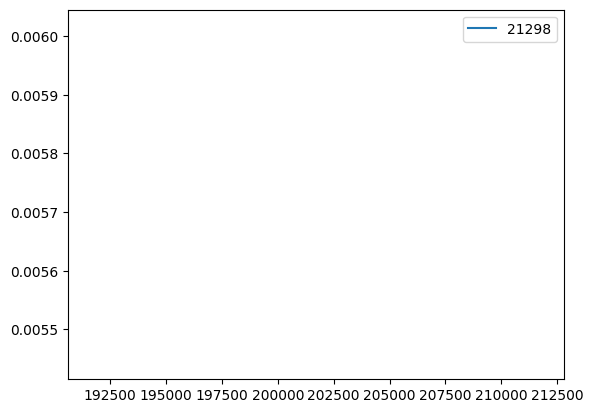

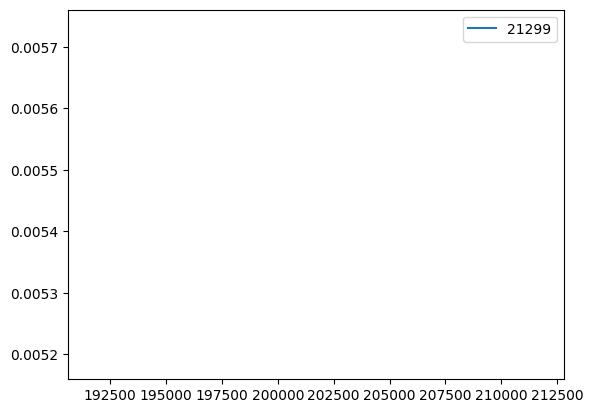

In [14]:
# para el producto 20275, en cada periodo, sumo el total de ventas para todos los customer_id
import matplotlib.pyplot as plt


def plot_product(product_id):
    product_df = benchmark_df.sort("periodo").filter(pl.col("product_id") == product_id).group_by("periodo").agg(pl.col("tn").sum())
    plt.plot(product_df["periodo"], product_df["tn"], label=product_id)
    plt.legend()
    plt.show()

for product_id in benchmark_df["product_id"].unique():
    plot_product(product_id)
